# Football Detection & Insights

The goal of this project is to extract meaningful insights from a short clip of a football match.  

The workflow is divided into three main phases:

- **Phase 1: Player Detection**  
  In this phase, I will apply computer vision techniques to automatically detect players throughout the video using YOLOv8 models.

- **Phase 2: Perspective Transformation**  
  After detection, a homography-based perspective transformation is applied to project player positions onto a top-down view of the football pitch.

- **Phase 3: Insight Generation**  
  Once player positions are mapped to the pitch, visual and statistical insights can be extracted:
  
  - Heatmaps showing the most occupied areas of the field  
  - Player distribution across field zones over time  
  - Convex hull area as a proxy for spatial occupation  
  - Lateral spread and player density

In [1]:
# Required for this notebook

import os
from tqdm.notebook import tqdm
import numpy as np
import matplotlib.pyplot as plt
import cv2
import json
from IPython.display import Image, display

## Input Video

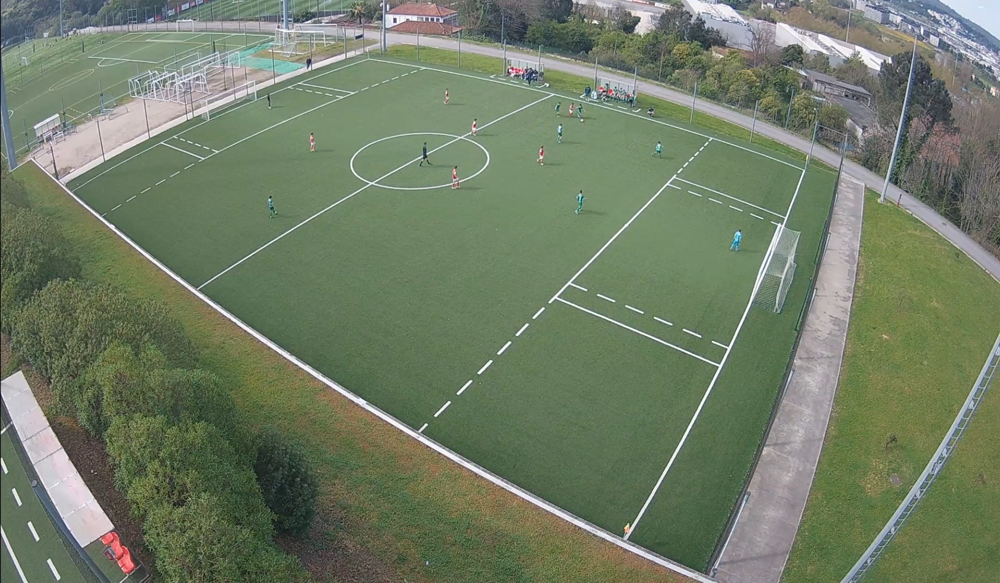

In [2]:
# Displaying a frame of the video as an example

display(Image(filename='./images/frame.png', width=800))

In [ ]:
# Getting the resolution of the video and frames per second

cap = cv2.VideoCapture('./input/video.mp4')

width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

print(f"Resolution: {width} x {height}")
print(f"FPS: {fps}")

Resolution: 1920 x 1080
FPS: 30.0


The video used in this project is located at `./input/video.mp4`.  

It is a color recording from a real 7-a-side football match, lasting approximately 8 minutes, with a resolution of 1920×1080 pixels and a frame rate of 30 FPS.

# Player Detection

## Baseline Detection using Pretrained Weights

For this task, I used the pre-trained **YOLOv8m** model provided by [Ultralytics](https://docs.ultralytics.com/pt/models/yolov8/).

I implemented a `DetectionYOLO` class (located in `detection.py`) to detect people in football videos using this model. The video processing pipeline is based on the official OpenCV guide: [Reading and Writing Videos Using OpenCV](https://opencv.org/blog/reading-and-writing-videos-using-opencv/).

The class reads the video frame by frame, performs person detection, saves the results to text files, and generates an annotated video output.


In [4]:
from ultralytics import YOLO

model = YOLO('yolov8m.pt')

In [5]:
print(model.names)

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microw

In [ ]:
from detection import DetectionYOLO

detection = DetectionYOLO(
    input_video_path='./input/video.mp4',
    output_video_path='./output_videos/video_yolov8m_standard.mp4',
    detections_path='./output_txt/video_yolov8m_standard',
    model_path='yolov8m.pt',
    minutes=2,
)

detection.run()

Video file opened successfully!

- Processing up to 3600 frames (~2 minute(s)).



Person Detection:   0%|          | 0/3600 [00:00<?, ?it/s]


0: 384x640 8 persons, 1 tennis racket, 54.3ms
Speed: 3.6ms preprocess, 54.3ms inference, 155.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 8 persons, 1 tennis racket, 9.4ms
Speed: 2.5ms preprocess, 9.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 9 persons, 1 tennis racket, 12.5ms
Speed: 1.7ms preprocess, 12.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 7 persons, 1 tennis racket, 10.2ms
Speed: 1.9ms preprocess, 10.2ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 9 persons, 1 tennis racket, 11.8ms
Speed: 1.7ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 9 persons, 1 tennis racket, 9.6ms
Speed: 1.6ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 9 persons, 1 tennis racket, 10.1ms
Speed: 1.9ms preprocess, 10.1ms inference, 2.4ms postprocess per image at shape (1, 3, 384,

## YOLOv8m Training on Football Player Dataset

To improve detection performance in football-specific scenarios, I trained a **YOLOv8m** model using a labeled dataset sourced from [Roboflow Universe](https://universe.roboflow.com/roboflow-jvuqo/football-field-detection-f07vi).

The dataset consists of approximately 320 annotated images capturing players on football fields. These annotations enable the model to specialize in detecting players within the unique spatial and visual context of football footage.

In [6]:
from roboflow import Roboflow
from dotenv import load_dotenv

In [7]:
# Download YOLOv8-compatible dataset from Roboflow using their API, following its documentation
# Reference: https://docs.roboflow.com/api-reference/images/upload-dataset

api_key = os.getenv('api_key')
rf = Roboflow(api_key=api_key)

project = rf.workspace("joaomr810").project("football-players-detection-3zvbc-qwdat")
version = project.version(3)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...


In [8]:
import torch

print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))

True
NVIDIA GeForce RTX 4060 Laptop GPU


In [4]:
!yolo task=detect mode=train model=yolov8m.pt data={dataset.location}/data.yaml epochs=25 imgsz=640 amp=False

New https://pypi.org/project/ultralytics/8.3.127 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.118  Python-3.12.7 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine\trainer: task=detect, mode=train, model=yolov8m.pt, data=c:\Users\Joao\Desktop\ISAG\2-T\Project\football-players-detection-3/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=False, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None,


train: Scanning C:\Users\Joao\Desktop\ISAG\2-T\Project\football-players-detection-3\train\labels.cache... 298 images, 0 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:00<?, ?it/s]
train: Scanning C:\Users\Joao\Desktop\ISAG\2-T\Project\football-players-detection-3\train\labels.cache... 298 images, 0 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:00<?, ?it/s]

val: Scanning C:\Users\Joao\Desktop\ISAG\2-T\Project\football-players-detection-3\valid\labels.cache... 49 images, 0 backgrounds, 0 corrupt: 100%|██████████| 49/49 [00:00<?, ?it/s]
val: Scanning C:\Users\Joao\Desktop\ISAG\2-T\Project\football-players-detection-3\valid\labels.cache... 49 images, 0 backgrounds, 0 corrupt: 100%|██████████| 49/49 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]
       1/25        12G      1.466      3.518     0.9355        600        640:   0%|          | 0/19 [00:19<?, ?it/s]
       1/25        12G      1.466      3.518     0.9355        600        640:   5%|▌         | 1/19 [00:1

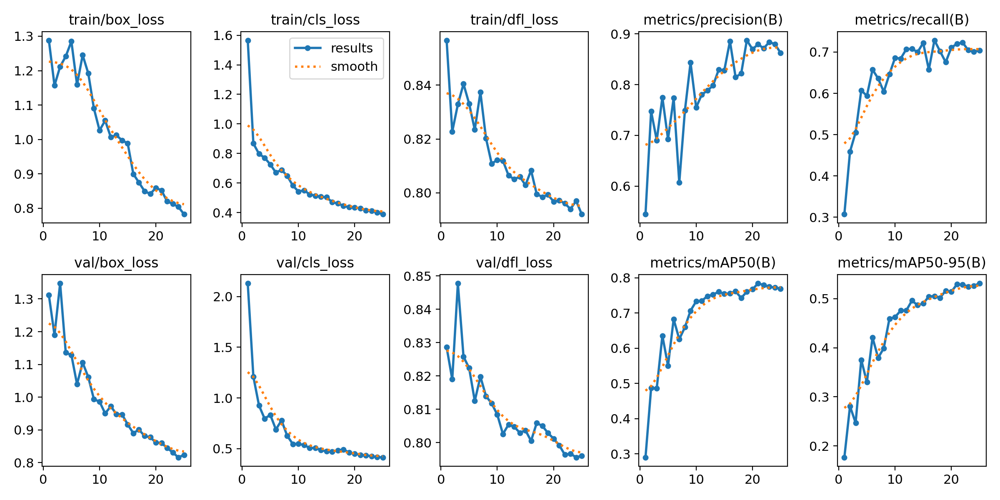

In [11]:
Image(filename='./runs/detect/train/results.png', width=1000)

We could train for a few more epochs considering the loss curves, however will check the metrics and if they are satisfatory will proceed as it is.

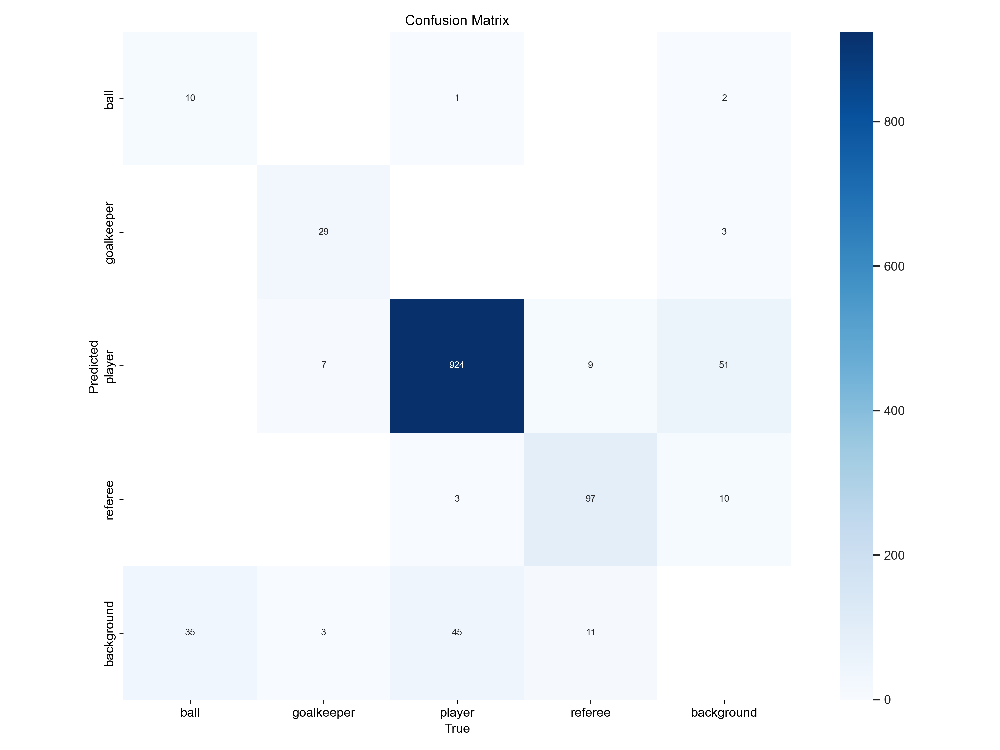

In [9]:
Image(filename='./runs/detect/train/confusion_matrix.png', width=1000)

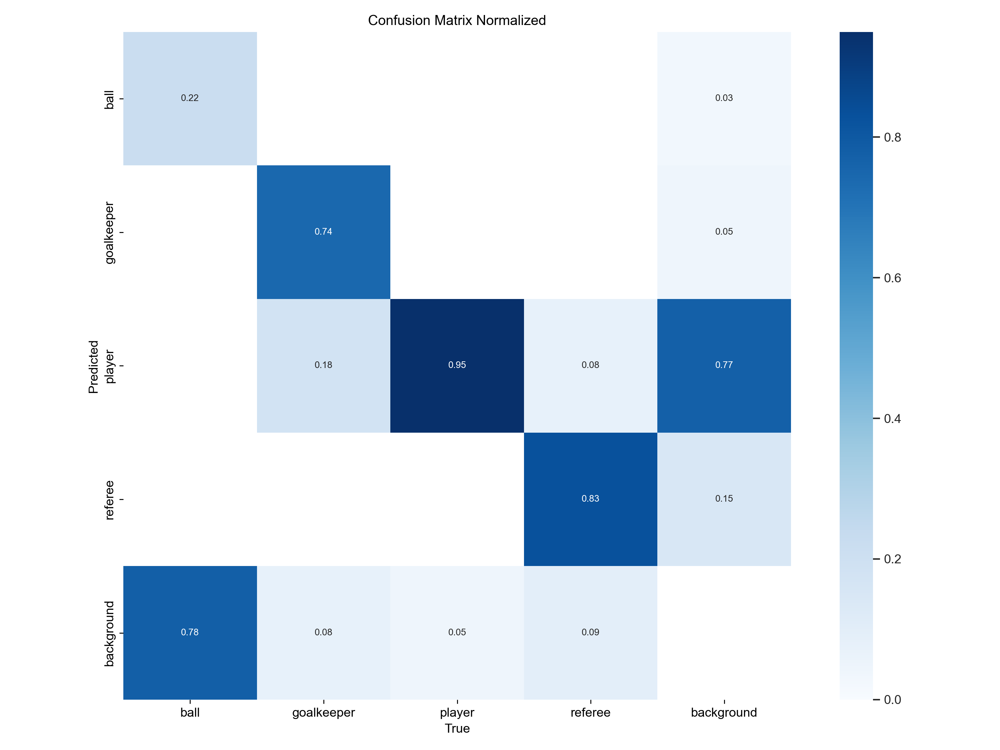

In [10]:
Image(filename='./runs/detect/train/confusion_matrix_normalized.png', width=1000)

The model detects well players which will be the main purpose of this project, while "ball" will be disregarded so its inefficiency is not problematic.

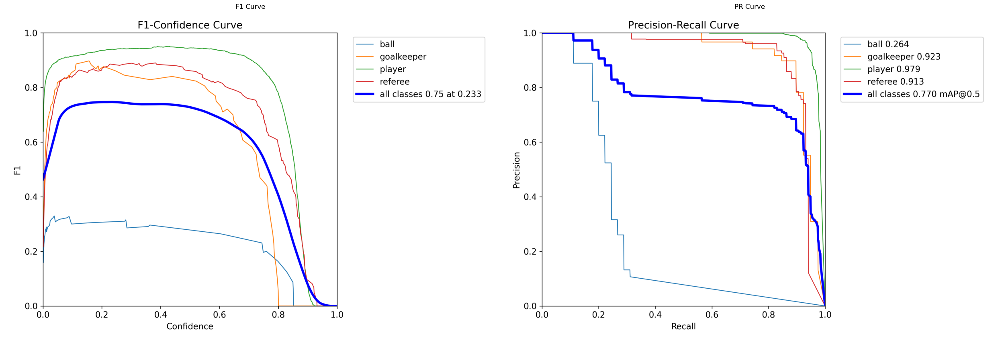

In [ ]:
# Showing F1-confidence and Precision-Recall curves

import matplotlib.image as mpimg

f1_path = './runs/detect/train/F1_curve.png'
pr_path = './runs/detect/train/PR_curve.png'

f1_img = mpimg.imread(f1_path)
pr_img = mpimg.imread(pr_path)

fig, axs = plt.subplots(1, 2, figsize=(25, 15))


axs[0].imshow(f1_img)
axs[0].set_title('F1 Curve')
axs[0].axis('off')  


axs[1].imshow(pr_img)
axs[1].set_title('PR Curve')
axs[1].axis('off')


plt.tight_layout()
plt.show()

Efficiency at detecting players is again noted, therefore will check how the model performs on the validation dataset.

In [94]:
!yolo task=detect mode=val model=./runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

Ultralytics 8.3.118  Python-3.12.7 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
Model summary (fused): 92 layers, 25,842,076 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access  (ping: 0.00.0 ms, read: 924.4225.0 MB/s, size: 104.5 KB)
                   all         49       1174      0.863      0.704       0.77      0.532
                  ball         45         45      0.673        0.2      0.264      0.117
            goalkeeper         38         39       0.94      0.803      0.923      0.647
                player         49        973      0.928      0.953      0.979      0.765
               referee         49        117       0.91      0.862      0.913        0.6
Speed: 0.8ms preprocess, 18.5ms inference, 0.0ms loss, 5.2ms postprocess per image
Results saved to c:\Users\Joao\runs\detect\val4
 Learn more at https://docs.ultralytics.com/modes/val



val: Scanning C:\Users\Joao\Desktop\ISAG\2-T\Project\football-players-detection-3\valid\labels.cache... 49 images, 0 backgrounds, 0 corrupt: 100%|██████████| 49/49 [00:00<?, ?it/s]
val: Scanning C:\Users\Joao\Desktop\ISAG\2-T\Project\football-players-detection-3\valid\labels.cache... 49 images, 0 backgrounds, 0 corrupt: 100%|██████████| 49/49 [00:00<?, ?it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/4 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 1/4 [00:02<00:08,  2.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 2/4 [00:03<00:02,  1.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 3/4 [00:03<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|█████

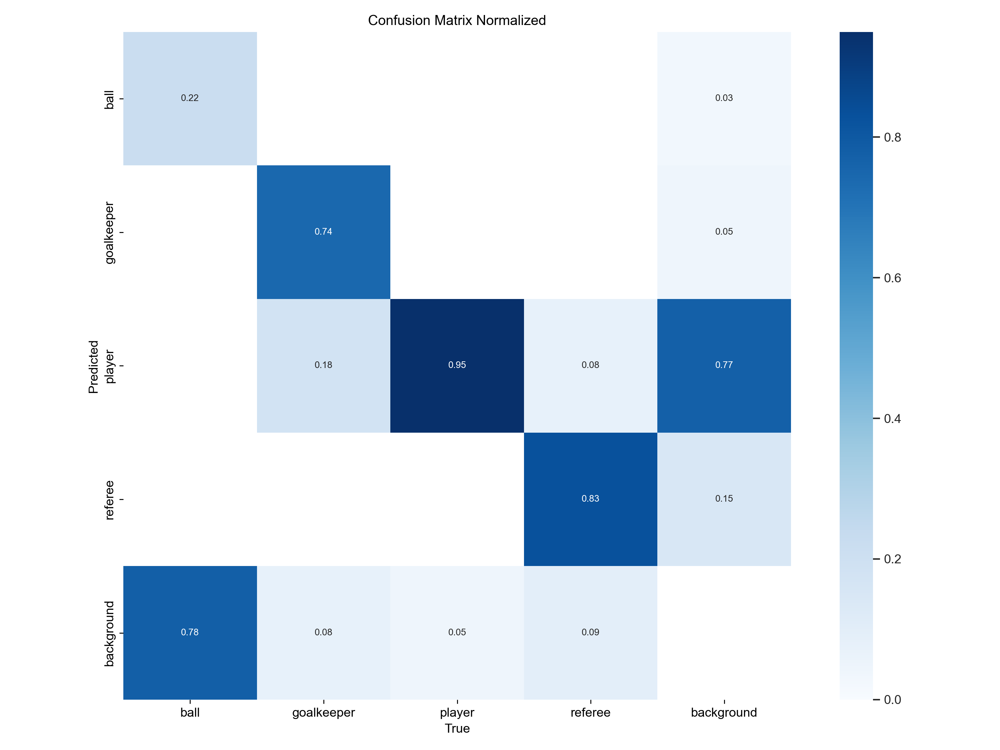

In [12]:
Image(filename='./runs/detect/val/confusion_matrix_normalized.png', width=1000)

Similar results obtained in the validation dataset, with more graphics at: `'./runs/detect/val/'`

Will proceed with the best instance of the model to detect players on the video.

In [13]:
model = YOLO('./runs/detect/train/weights/best.pt')

print(model.names)

{0: 'ball', 1: 'goalkeeper', 2: 'player', 3: 'referee'}


The best instance of the custom-trained model is loaded from `./runs/detect/train/weights/best.pt`.  
Since the label set differs from the standard YOLO classes, I created a `DetectionCustom` class in `detection.py`, which is configured to detect only classes `[1, 2]` — corresponding to goalkeepers and players — in line with the objectives of this project.

In [ ]:
from detection import DetectionCustom

detection = DetectionCustom(
    input_video_path='./input/video.mp4',
    output_video_path='./output_videos/video_yolov8m_train.mp4',
    detections_path='./output_txt/video_yolov8m_train',
    model_path='./runs/detect/train/weights/best.pt',
    minutes=2,
)

detection.run()

Video file opened successfully!
- Processing up to 3600 frames (~2 minute(s)).



Player Detection:   0%|          | 0/3600 [00:00<?, ?it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 41.7ms
Speed: 2.6ms preprocess, 41.7ms inference, 99.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 10.1ms
Speed: 1.8ms preprocess, 10.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 12.7ms
Speed: 1.6ms preprocess, 12.7ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 10.1ms
Speed: 1.3ms preprocess, 10.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 1 referee, 10.1ms
Speed: 2.2ms preprocess, 10.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 1 referee, 10.3ms
Speed: 1.4ms preprocess, 

## Comparing standard YOLOv8m and the best instance of trained YOLOv8m

In [14]:
from utils import draw_boxes

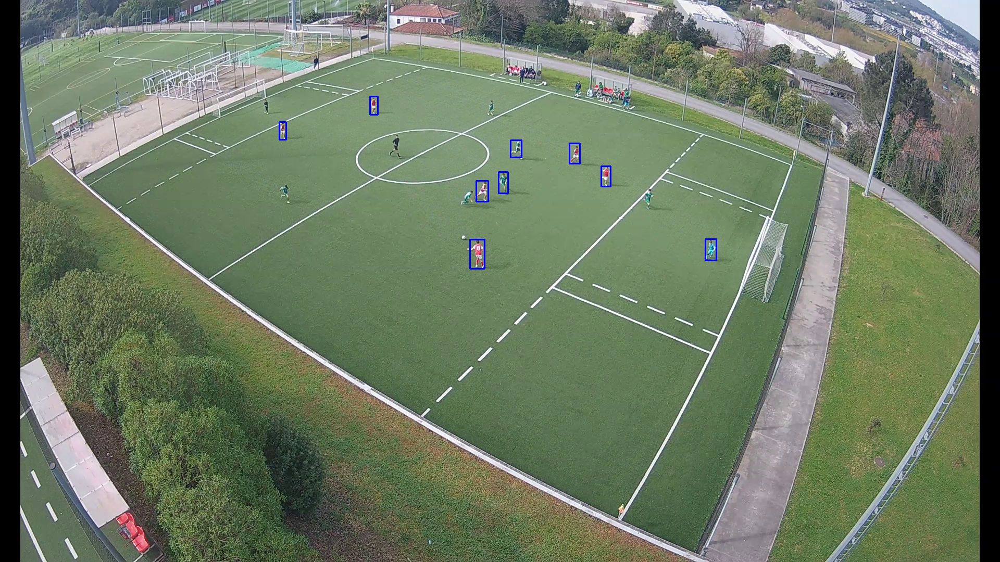

In [15]:
# Configuration to extract a specific frame with the bounding boxes using yolov8m_standard detections
video_path = './input/video.mp4'
frame_number = 1804
model_name = 'yolov8m_standard'
text_path = f'./output_txt/video_{model_name}/001804.txt'
save_path = f'./images/{model_name}_frame{frame_number}.png'

# Read the specified frame from the video
cap = cv2.VideoCapture(video_path)
cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number)
ret, frame = cap.read()
cap.release()

if not ret:
    raise RuntimeError("Failed to read the video frame.")

# Draw bounding boxes directly on the frame using detections from the .txt file
# The box color is specified in BGR format as it is the OpenCV default
draw_boxes(frame, text_path, (255, 0, 0))

# Ensure the output directory exists and save the annotated image
os.makedirs(os.path.dirname(save_path), exist_ok=True)
cv2.imwrite(save_path, frame)

# Display the saved image in the notebook
display(Image(filename=save_path, width=900))

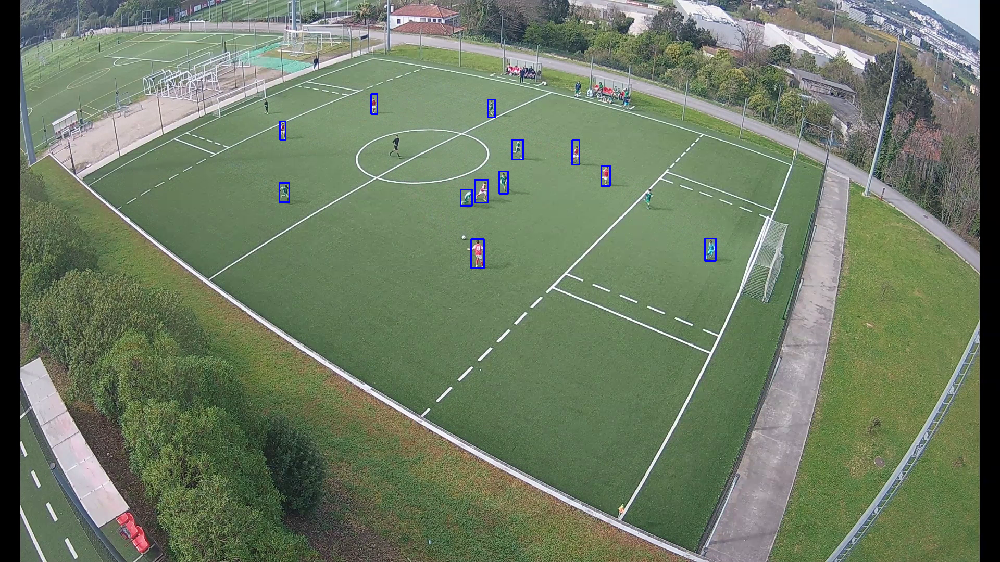

In [17]:
# Same as above but for yolov8m_train detections

video_path = './input/video.mp4'
frame_number = 1804
model_name = 'yolov8m_train'
text_path = f'./output_txt/video_{model_name}/001804.txt'
save_path = f'./images/{model_name}_frame{frame_number}.png'

cap = cv2.VideoCapture(video_path)
cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number)
ret, frame = cap.read()
cap.release()

if not ret:
    raise RuntimeError("Failed to read the video frame.")

draw_boxes(frame, text_path, (255, 0, 0))

os.makedirs(os.path.dirname(save_path), exist_ok=True)
cv2.imwrite(save_path, frame)

display(Image(filename=save_path, width=900))

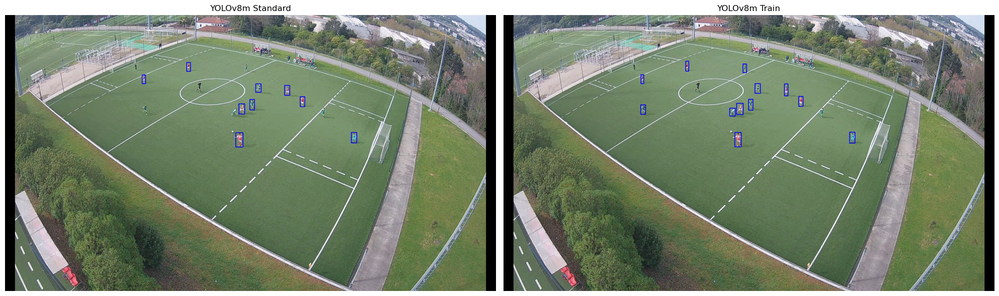

In [7]:
# Load both images using OpenCV
img1 = cv2.imread('./images/yolov8m_standard_frame1804.png')
img2 = cv2.imread('./images/yolov8m_train_frame1804.png')

# Convert images from BGR (OpenCV format) to RGB as it is the expected with matplotlib
img1_rgb = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2_rgb = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Displaying the two images side by side
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

axes[0].imshow(img1_rgb)
axes[0].set_title("YOLOv8m Standard")
axes[0].axis('off')

axes[1].imshow(img2_rgb)
axes[1].set_title("YOLOv8m Train")
axes[1].axis('off')

plt.tight_layout()
plt.show()

## Final Detection Output

So far, I have tested two different YOLOv8 models on a short 2-minute segment of the input video to evaluate their performance. Analyzing the 2-minute video and frames, the custom-trained model provided better and more consistent results in this specific football setting.

Based on these observations, I will now apply the same custom model to the full 8-minute video. This will generate a complete set of detections, which I will use in the next phase to extract spatial and movement-based insights.

In [72]:
from detection import DetectionCustom

detection = DetectionCustom(
    input_video_path='./input/video.mp4',
    output_video_path='./output_videos/video_full.mp4',
    detections_path='./output_txt/video_full',
    model_path='./runs/detect/train/weights/best.pt',
    minutes=8
)

detection.run()

Video file opened successfully!
- Processing up to 14400 frames (~8 minute(s)).



Player Detection:   0%|          | 0/14400 [00:00<?, ?it/s]


0: 384x640 1 goalkeeper, 19 players, 1 referee, 12.3ms
Speed: 2.6ms preprocess, 12.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 9.2ms
Speed: 1.4ms preprocess, 9.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 9.1ms
Speed: 1.9ms preprocess, 9.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 9.0ms
Speed: 1.6ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 19 players, 1 referee, 11.9ms
Speed: 2.0ms preprocess, 11.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 1 referee, 9.2ms
Speed: 1.3ms preprocess, 9.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 goalkeeper, 18 players, 1 referee, 10.5ms
Speed: 1.3ms preprocess, 10.5ms in

# Perspective Transformation

In order to generate visual insights, I need to convert the original camera view into a top-down perspective of the pitch. Since the camera is fixed, I can apply a homography transformation using just four reference points — specifically, the four corners of the football field, defined by their pixel coordinates in the image.

In [43]:
from utils import annotate_pitch_corners

In [44]:
corners = annotate_pitch_corners()

In [21]:
corners

[[126, 340], [648, 104], [1416, 302], [1096, 956]]

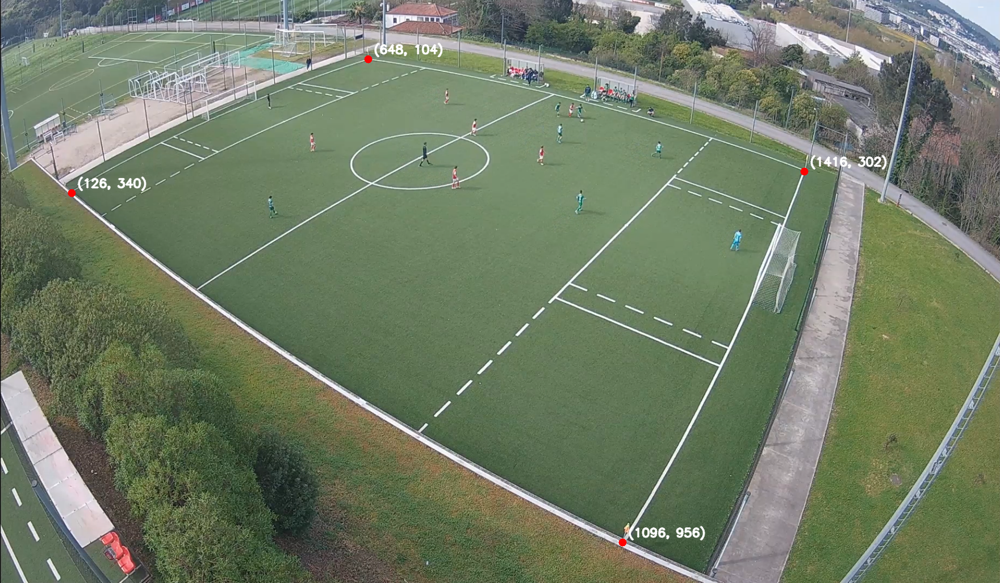

In [22]:
display(Image(filename='./images/frame_annotated.png', width=900))

(<Figure size 640x480 with 1 Axes>, <Axes: >)

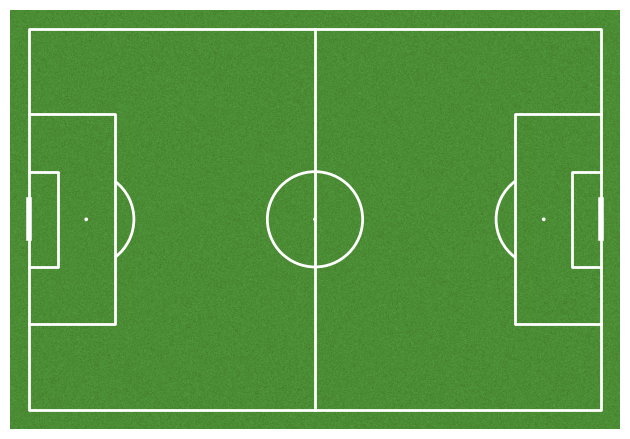

In [23]:
from mplsoccer import Pitch

pitch = Pitch(pitch_color='grass', line_color='white')

pitch.draw()

In [24]:
image_points = np.array([
    [648, 104],     # top left corner
    [1416, 302],    # top right corner
    [1096, 956],    # bottom right corner
    [126, 340]      # bottom left corner
])

field_points = np.array([
    [0, 0],       # top left corner
    [120, 0],     # top right corner
    [120, 80],    # bottom right corner
    [0, 80]       # bottom left corner
], dtype=np.float32)

H, _ = cv2.findHomography(image_points, field_points)

In [25]:
from utils import image_to_pitch

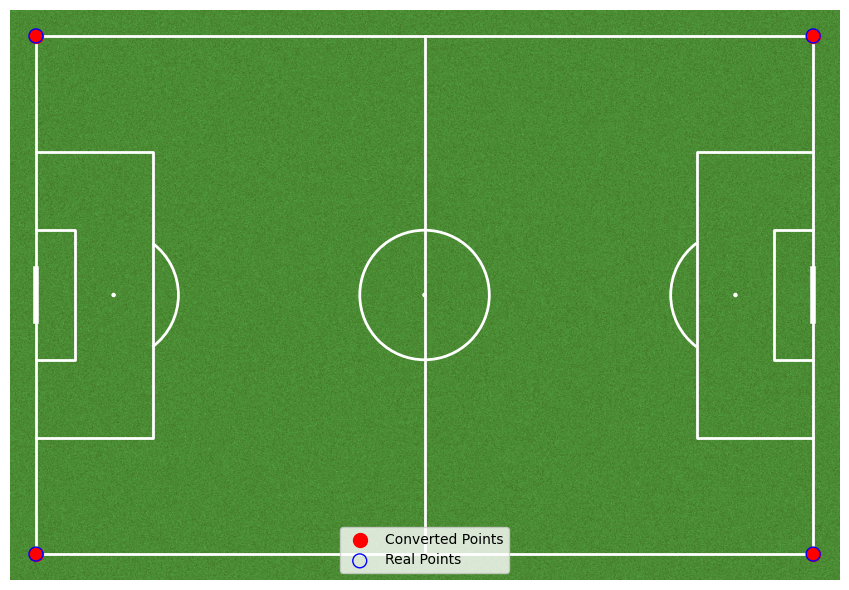

In [ ]:
# Applying the image_to_pitch function to the 4 corner coordinates and check if they were correctly applied

converted_points = [image_to_pitch(x, y, H) for (x, y) in image_points]

fig, ax = pitch.draw(figsize=(10, 6))
xs, ys = zip(*converted_points)
ax.scatter(xs, ys, color='red', s=100, label='Converted Points')
fx, fy = zip(*field_points)
ax.scatter(fx, fy, facecolors='none', edgecolors='blue', s=100, label='Real Points')
ax.legend()
plt.show()

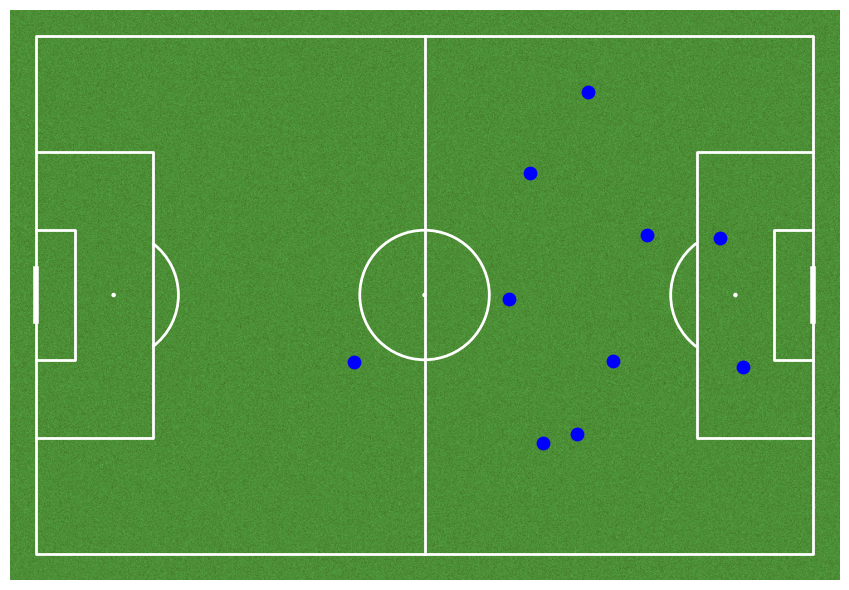

In [27]:
# Load player detections from a specific frame file and project them into pitch coordinates

frame_file = './output_txt/video_full/005000.txt'
player_positions_pitch = []       # To store (x, y) positions projected in the pitch

with open(frame_file, 'r') as f:
    for line in f:
        parts = line.strip().split(',')
        _, _, x, y, w, h, conf, *_ = map(float, parts)  # Extract bounding box info (x, y, w, h)

        # Calculate the bottom-center of the bounding box, representing the player's foot position
        # Note: x and y refer to the top-left corner of the bounding box
        base_x = x + w / 2
        base_y = y + h

        pitch_x, pitch_y = image_to_pitch(base_x, base_y, H)

        if 0 <= pitch_x <= 120 and 0 <= pitch_y <= 80:      # To check if detetion is inside the pitch (or it is background noise)
            player_positions_pitch.append((pitch_x, pitch_y))

# Plot the pitch and the projected player positions
fig, ax = pitch.draw(figsize=(10, 6))


if player_positions_pitch:
    px, py = zip(*player_positions_pitch)
    ax.scatter(px, py, color='blue', s=80)
    
plt.show()

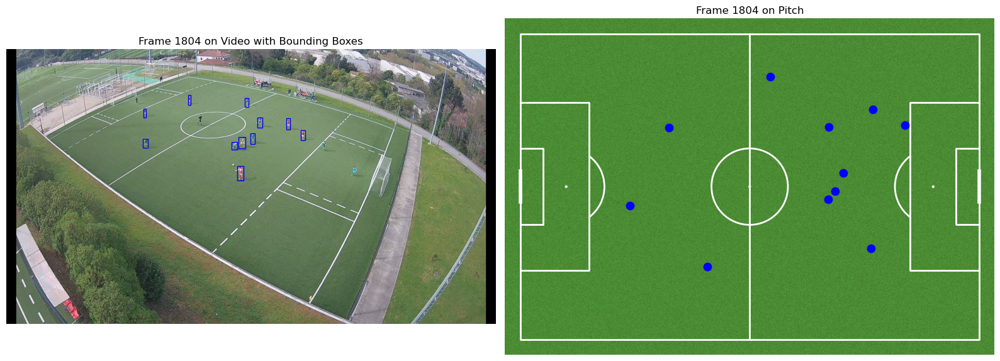

In [28]:
video_path = './input/video.mp4'
frame_file = './output_txt/video_full/001804.txt'
frame_number = 1804

# Read the video and extract the specific frame
cap = cv2.VideoCapture(video_path)
cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number)
ret, frame = cap.read()
cap.release()

# Convert the frame to RGB for displaying it with matplotlib
frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

# To store player positions in both real image and pitch coordinates
player_positions_img = []
player_positions_pitch = []

# Read detections from the frame's .txt file
with open(frame_file, 'r') as f:
    for line in f:
        parts = line.strip().split(',')
        _, _, x, y, w, h, conf, *_ = map(float, parts)

        base_x = x + w / 2
        base_y = y + h

        pitch_x, pitch_y = image_to_pitch(base_x, base_y, H)

        if 0 <= pitch_x <= 120 and 0 <= pitch_y <= 80:
            player_positions_img.append((x, y, w, h))
            player_positions_pitch.append((pitch_x, pitch_y))


# Create side-by-side plots: original frame + pitch view
fig, axes = plt.subplots(1, 2, figsize=(16, 6))


axes[0].imshow(frame_rgb)
axes[0].axis('off')
axes[0].set_title(f"Frame {frame_number} on Video with Bounding Boxes")
for (x, y, w, h) in player_positions_img:
    rect = plt.Rectangle((x, y), w, h, edgecolor='blue', facecolor='none', linewidth=1)
    axes[0].add_patch(rect)


pitch.draw(ax=axes[1])
if player_positions_pitch:
    px, py = zip(*player_positions_pitch)
    axes[1].scatter(px, py, color='blue', s=80)

axes[1].set_title(f"Frame {frame_number} on Pitch")
plt.tight_layout()
plt.show()

# Extracting Insights

Now that I have validated both the player detection process and the corresponding 2D perspective transformation, I can proceed to the next step: extracting meaningful insights from the positional players' data.

## Heatmap

To visualize player presence and identify the most occupied zones of the pitch, I will generate heatmaps based on the player coordinates obtained from the perspective transformation.

For this purpose, I relied on the `mplsoccer` library. The implementation is based on the official documentation available here: [mplsoccer heatmap example](https://mplsoccer.readthedocs.io/en/latest/gallery/pitch_plots/plot_heatmap.html#).

In [29]:
# Load all player detections across the full video by parsing every .txt file in the detections directory

detections_dir = './output_txt/video_full'
all_positions = []

for filename in tqdm(sorted(os.listdir(detections_dir))):
    if not filename.endswith('.txt'):
        continue

    filepath = os.path.join(detections_dir, filename)

    with open(filepath, 'r') as f:
        for line in f:
            parts = line.strip().split(',')
            _, _, x, y, w, h, conf, *_ = map(float, parts)

            base_x = x + w / 2
            base_y = y + h

            pitch_x, pitch_y = image_to_pitch(base_x, base_y, H)

            if 0 <= pitch_x <= 120 and 0 <= pitch_y <= 80:
                all_positions.append((pitch_x, pitch_y))

  0%|          | 0/14341 [00:00<?, ?it/s]

In [30]:
all_positions

[(89.56351237041987, 28.80031913243641),
 (64.47220361589028, 7.683462041730158),
 (100.37301062392478, 42.34915975998601),
 (57.84683218592465, 50.19355501866701),
 (66.07730134413686, 63.01677138200075),
 (30.19053554529064, 49.51473433822931),
 (60.94666608802979, 32.71602675599127),
 (59.70269958363438, 43.8444345460141),
 (89.57826288009507, 28.8380470771048),
 (64.47386322765517, 7.692186410734833),
 (100.36718920891155, 42.31111326992678),
 (57.83432237245935, 50.19056221169193),
 (65.90333948326771, 62.93368918731995),
 (30.183601620860042, 49.47960624476791),
 (61.0119559454894, 32.788577181875915),
 (115.53729784943768, 19.758641527352932),
 (89.53099309051895, 28.83242955382361),
 (64.34338163587543, 7.702418904011478),
 (100.36937740339916, 42.30337433218638),
 (57.850516898345134, 50.19134899941983),
 (65.8411311278196, 63.01945039070754),
 (30.348971563047137, 49.59392798000401),
 (61.19342764255332, 33.07653474250584),
 (89.33950026348089, 28.662731554989538),
 (64.33505

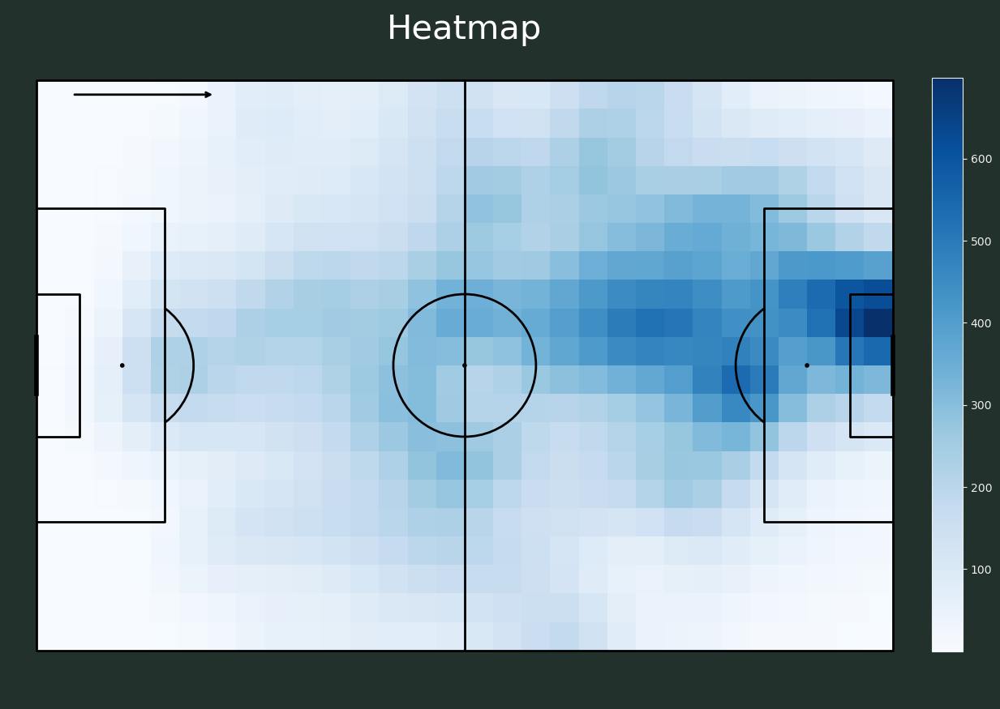

In [31]:
import matplotlib.patheffects as path_effects
from scipy.ndimage import gaussian_filter

pitch = Pitch(pitch_color='#22312b', line_color='black', line_zorder=2)
fig, axs = pitch.grid(endnote_height=0.03, endnote_space=0,
                      # leave some space for the colorbar
                      grid_width=0.88, left=0.025,
                      title_height=0.06, title_space=0,
                      axis=False,
                      grid_height=0.86)
fig.set_facecolor('#22312b')

# plot heatmap
x, y = zip(*all_positions)
bin_statistic = pitch.bin_statistic(x, y, statistic='count', bins=(30, 20))
bin_statistic['statistic'] = gaussian_filter(bin_statistic['statistic'], 1)
pcm = pitch.heatmap(bin_statistic, ax=axs['pitch'], cmap='Blues')

# add an arrow indicating the attacking direction (right to left)
axs['pitch'].annotate(
    '', xy=(25, 2), xytext=(5, 2),
    arrowprops=dict(arrowstyle='->', lw=2)
)

# add color bar
ax_cbar = fig.add_axes((0.915, 0.093, 0.03, 0.786))
cbar = plt.colorbar(pcm, cax=ax_cbar)
cbar.outline.set_edgecolor('#efefef')
cbar.ax.yaxis.set_tick_params(color='#efefef')
plt.setp(plt.getp(cbar.ax.axes, 'yticklabels'), color='#efefef')
for label in cbar.ax.get_yticklabels():
    label.set_fontsize(10)


# endnote and title
ax_title = axs['title'].text(0.5, 0.5, "Heatmap", color='white',
                             va='center', ha='center', fontsize=30)

## Player Occupation by Field Zone

Will show the percentage of total player detections that occurred in each field zone of the pitch.

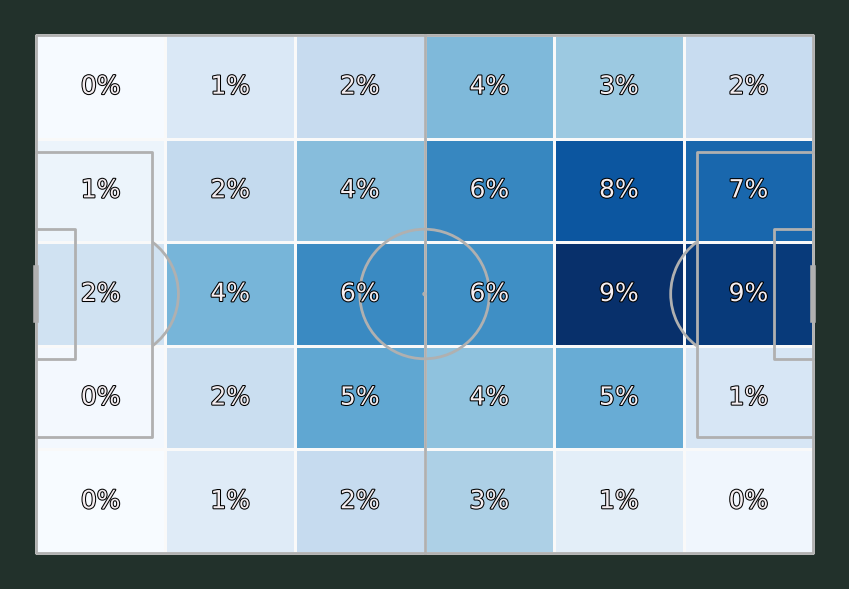

In [32]:
path_eff = [path_effects.Stroke(linewidth=1.5, foreground='black'),
            path_effects.Normal()]

pitch = Pitch(pitch_color='#22312b', line_zorder=2)
fig, ax = pitch.draw(figsize=(10, 6))
fig.set_facecolor('#22312b')
bin_statistic = pitch.bin_statistic(x, y, statistic='count', bins=(6, 5), normalize=True)
pitch.heatmap(bin_statistic, ax=ax, cmap='Blues', edgecolor='#f9f9f9')
labels = pitch.label_heatmap(bin_statistic, color='#f4edf0', fontsize=18,
                             ax=ax, ha='center', va='center',
                             str_format='{:.0%}', path_effects=path_eff)

Text(0.5, 0.93, 'Player Occupation by Field Zone')

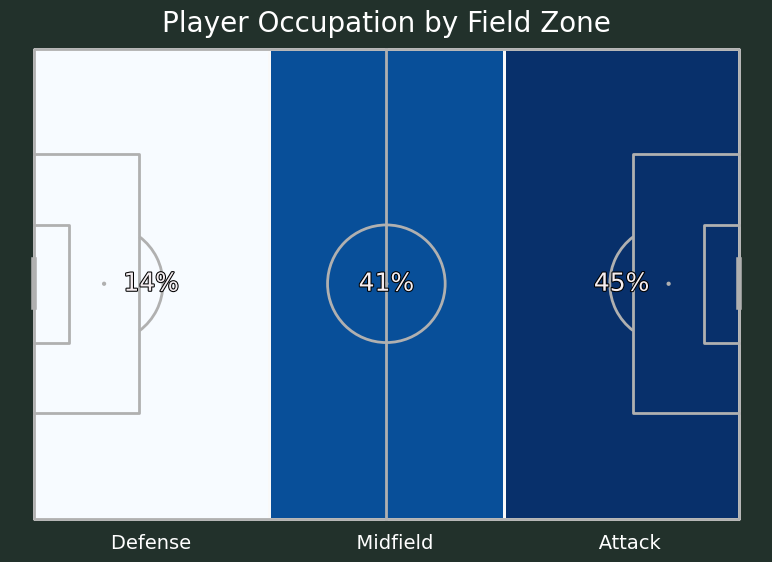

In [33]:
pitch = Pitch(pitch_color='#22312b', line_zorder=2)
fig, ax = pitch.draw(figsize=(10, 6))
fig.set_facecolor('#22312b')
bin_statistic = pitch.bin_statistic(x, y, statistic='count', bins=(3, 1), normalize=True)
pitch.heatmap(bin_statistic, ax=ax, cmap='Blues', edgecolor='#f9f9f9')
labels = pitch.label_heatmap(bin_statistic, color='#f4edf0', fontsize=18,
                             ax=ax, ha='center', va='center',
                             str_format='{:.0%}', path_effects=path_eff)

zone_names = ['Defense', 'Midfield', 'Attack']
summary = [f'{zone}'for zone in zone_names]
summary_str ='                           '.join(summary)

ax.text(0.5, 0, summary_str, transform=ax.transAxes,
        ha='center', va='center', fontsize=14, color='white')

fig.suptitle("Player Occupation by Field Zone", fontsize=20, color='white', y=0.93)

## Average Number of Players per Field Sector (per Frame)

This analysis shows the average number of players per sector (defense, midfield, attack), considering only frames with at least 11 detections.

In [34]:
detections_dir = './output_txt/video_full'
positions_by_frame = []

for filename in tqdm(sorted(os.listdir(detections_dir))):
    if not filename.endswith('.txt'):
        continue

    frame_id = int(filename.split('.')[0])
    filepath = os.path.join(detections_dir, filename)

    with open(filepath, 'r') as f:
        for line in f:
            parts = line.strip().split(',')
            _, _, x, y, w, h, conf, *_ = map(float, parts)

            base_x = x + w / 2
            base_y = y + h

            pitch_x, pitch_y = image_to_pitch(base_x, base_y, H)

            if 0 <= pitch_x <= 120 and 0 <= pitch_y <= 80:
                positions_by_frame.append((frame_id, pitch_x, pitch_y))

  0%|          | 0/14341 [00:00<?, ?it/s]

In [35]:
from collections import defaultdict

detections_by_frame = defaultdict(list)

for frame_id, x, y in positions_by_frame:
    detections_by_frame[frame_id].append((x, y))

In [36]:
detections_by_frame

defaultdict(list,
            {0: [(89.56351237041987, 28.80031913243641),
              (64.47220361589028, 7.683462041730158),
              (100.37301062392478, 42.34915975998601),
              (57.84683218592465, 50.19355501866701),
              (66.07730134413686, 63.01677138200075),
              (30.19053554529064, 49.51473433822931),
              (60.94666608802979, 32.71602675599127),
              (59.70269958363438, 43.8444345460141)],
             1: [(89.57826288009507, 28.8380470771048),
              (64.47386322765517, 7.692186410734833),
              (100.36718920891155, 42.31111326992678),
              (57.83432237245935, 50.19056221169193),
              (65.90333948326771, 62.93368918731995),
              (30.183601620860042, 49.47960624476791),
              (61.0119559454894, 32.788577181875915),
              (115.53729784943768, 19.758641527352932)],
             2: [(89.53099309051895, 28.83242955382361),
              (64.34338163587543, 7.70241890401147

In [39]:
# Define sector boundaries (x-axis of the transformed pitch - from 0 to 120)
defense_limit = 40
midfield_limit = 80

# Counters per frame
def_counts = []
mid_counts = []
att_counts = []

for frame_id in detections_by_frame.keys():
    positions = detections_by_frame[frame_id]
    if len(positions) <= 10:
        continue
    
    else:
        n_def = sum(1 for x, _ in positions if x < defense_limit)
        n_mid = sum(1 for x, _ in positions if defense_limit <= x < midfield_limit)
        n_att = sum(1 for x, _ in positions if x >= midfield_limit)

        def_counts.append(n_def)
        mid_counts.append(n_mid)
        att_counts.append(n_att)

# Compute averages per sector
mean_def = np.mean(def_counts)
mean_mid = np.mean(mid_counts)
mean_att = np.mean(att_counts)

print("Average number of players per frame (in frames with => 11 detections):")
print(f"  Defense: {mean_def:.2f}")
print(f"  Midfield: {mean_mid:.2f}")
print(f"  Attack: {mean_att:.2f}")

Average number of players per frame (in frames with => 11 detections):
  Defense: 0.91
  Midfield: 4.20
  Attack: 6.15


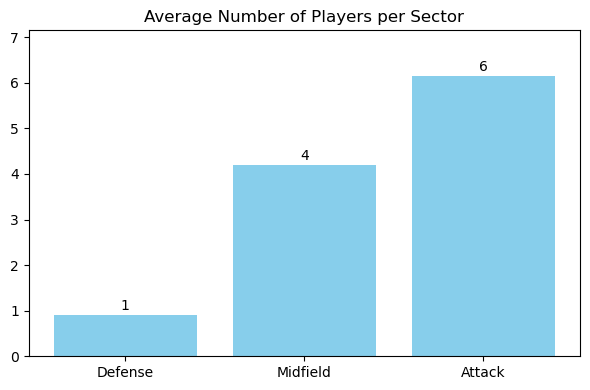

In [40]:
# Showing the average number of players per sector in matplotlib graphic

sectors = ['Defense', 'Midfield', 'Attack']
means = [mean_def, mean_mid, mean_att]

plt.figure(figsize=(6, 4))
bars = plt.bar(sectors, means, color='skyblue')
plt.title('Average Number of Players per Sector')
plt.ylim(0, max(means) + 1)

# Annotate each bar with its value
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.1, f'{height:.0f}', ha='center')

plt.tight_layout()
plt.show()

## Spatial Occupation: Convex Hull

This analysis computes the area covered by all detected players in each frame using a convex hull, serving as a proxy for team compactness or dispersion over time.

The convex hull area is computed using `scipy.spatial.ConvexHull`, and the visualization follows the guidelines from `mplsoccer`.

- [mplsoccer – Convex Hull Plot Example](https://mplsoccer.readthedocs.io/en/latest/gallery/pitch_plots/plot_convex_hull.html)
- [scipy.spatial.ConvexHull – Documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.ConvexHull.html)

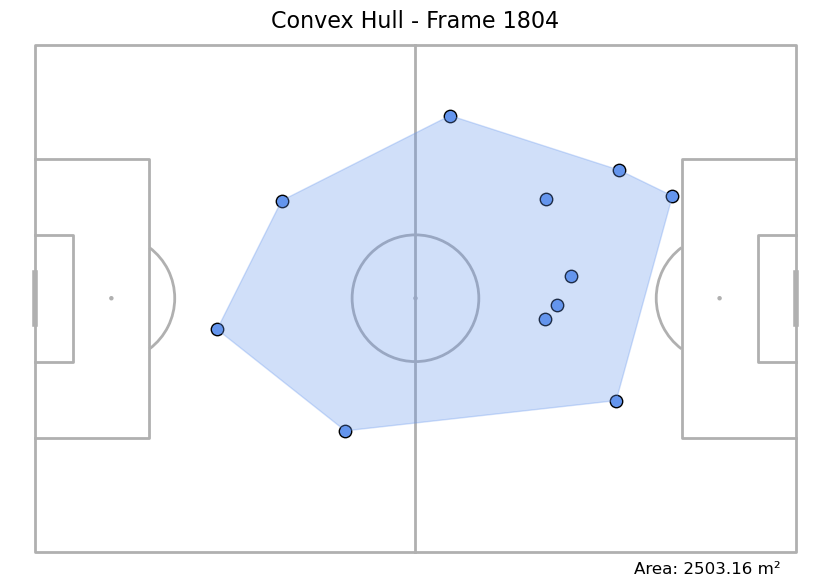

In [41]:
from scipy.spatial import ConvexHull

# Select the frame to visualize and a list of tuple (x, y) with its detections
chosen_frame_id = 1804
positions = detections_by_frame[chosen_frame_id]

# Extract x and y coordinates from the player positions
x = [pt[0] for pt in positions]
y = [pt[1] for pt in positions]

# Compute the convex hull and its area -- scipy.spatial documentation
points = np.array(list(zip(x, y)))
hull_scipy = ConvexHull(points)
area = hull_scipy.volume

# Create the pitch and plot the data -- mplsoccer documentation
pitch = Pitch()
fig, ax = pitch.draw(figsize=(10, 6))
hull = pitch.convexhull(x, y)
scatter = pitch.scatter(x, y, ax=ax, s=80, color='black', facecolor='cornflowerblue')
poly = pitch.polygon(hull, ax=ax, edgecolor='cornflowerblue', facecolor='cornflowerblue', alpha=0.3)

# Add title and area of the convex hull as 'legend'
ax.set_title(f'Convex Hull - Frame {chosen_frame_id}', fontsize=16, color='black', y=0.97)
ax.text(0.95, 0.00, f'Area: {area:.2f} m²',
        transform=ax.transAxes,
        ha='right', va='bottom',
        fontsize=12, color='black')
plt.show()

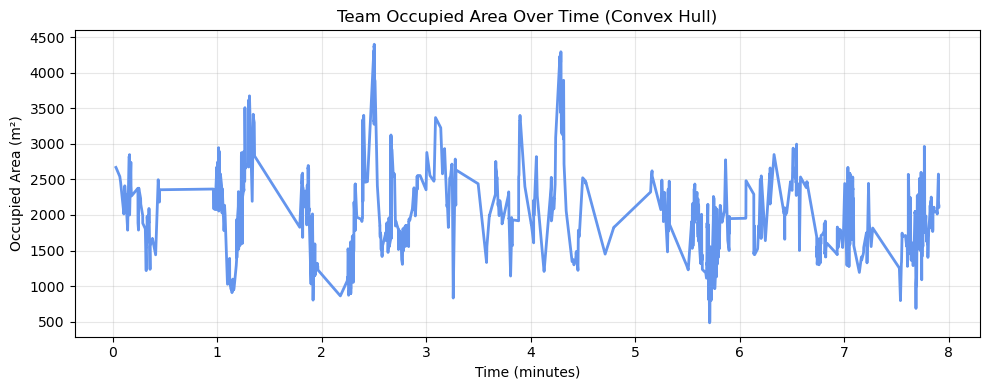

Average occupied area across valid frames: 2026.32 m²


In [42]:
# Compute the convex hull area for all frames with more than 10 player detections
# This is used to track team dispersion/compactness over time

areas = []
times = []
fps = 30        # video is 30 fps

for frame_id in detections_by_frame.keys():
    positions = detections_by_frame[frame_id]

    if len(positions) < 10:
        continue
    
    else:
        points = np.array(positions)
        hull = ConvexHull(points)
        area = hull.volume
        areas.append(area)
        times.append(frame_id / (fps * 60))      # in minutes

plt.figure(figsize=(10, 4))
plt.plot(times, areas, color='cornflowerblue', linewidth=2)
plt.xlabel('Time (minutes)')
plt.ylabel('Occupied Area (m²)')
plt.title('Team Occupied Area Over Time (Convex Hull)')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Print average area
average_area = np.mean(areas)
print(f'Average occupied area across valid frames: {average_area:.2f} m²')

## Player Lateral Spread

This analysis measures the spread of all detected players across the width of the field in each frame, providing a general view of how compact or wide the overall player distribution is over time.

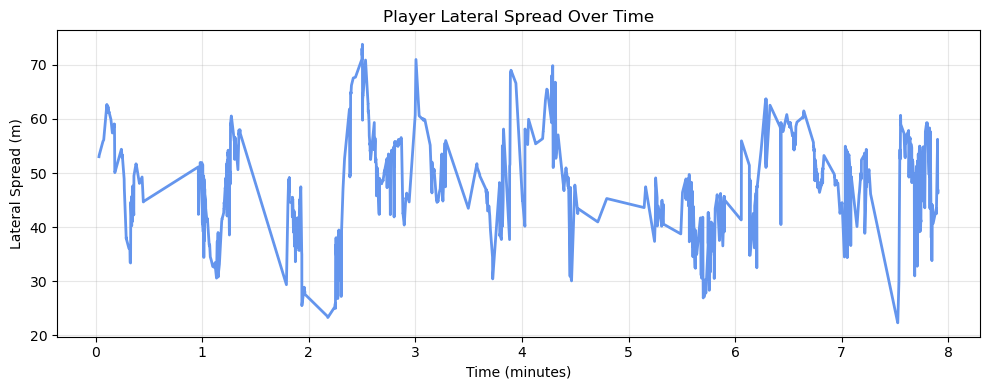

Average lateral spread across valid frames: 48.15 meters


In [43]:
widths = []
times = []
fps = 30        # video is 30 fps

for frame_id in sorted(detections_by_frame.keys()):
    positions = detections_by_frame[frame_id]

    if len(positions) < 10:
        continue
    
    else:
        y_coords = [pt[1] for pt in positions]
        width = max(y_coords) - min(y_coords)
        widths.append(width)
        times.append(frame_id / (fps * 60))  # convert to minutes

# Plot width over time
plt.figure(figsize=(10, 4))
plt.plot(times, widths, color='cornflowerblue', linewidth=2)
plt.xlabel('Time (minutes)')
plt.ylabel('Lateral Spread (m)')
plt.title('Player Lateral Spread Over Time')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

average_width = np.mean(widths)
print(f'Average lateral spread across valid frames: {average_width:.2f} meters')